In [ ]:
#!python3 -m pip install torch
#!python3 -m pip install matplotlib
#!python3 -m pip install numpy

# Neural Network basics

In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
import plotly.express as px

# Some work with tensors

## All Types of Tensor

In [ ]:
torch.HalfTensor    # 2 byte, floating point
torch.FloatTensor   # 4 byte, floating point
torch.DoubleTensor  # 8 byte, floating point

torch.ShortTensor   # 2 byte, integer, signed
torch.IntTensor     # 4 byte, integer, signed
torch.LongTensor    # 8 byte, integer, signed

torch.CharTensor    # 1 byte, integer, signed
torch.ByteTensor    # 1 byte, integer, unsigned

torch.ByteTensor

## How to create tensor

### From python object

In [ ]:
python_list = [[1, 2, 2], [-1, -3, 0]]

x = torch.tensor(python_list)
print(f'using torch.tensor: {x.dtype}')

# torch.Tensor is an alias for the default tensor type (torch.FloatTensor)
x = torch.Tensor(python_list)
print(f'using torch.Tensor: {x.dtype}')

using torch.tensor: torch.int64
using torch.Tensor: torch.float32


In [ ]:
x.shape

torch.Size([2, 3])

In [ ]:
python_list = [[True, False], [False, False]]

x = torch.tensor(python_list)
print(f'using torch.tensor: {x.dtype}')

x = torch.Tensor(python_list)
print(f'using torch.Tensor: {x.dtype}')

x = torch.IntTensor(python_list)
print(f'using torch.IntTensor: {x.dtype}')

using torch.tensor: torch.bool
using torch.Tensor: torch.float32
using torch.IntTensor: torch.int32


In [ ]:
bad_python_list = [[1., 3.], [2., -1., 0.]]

x = torch.tensor(bad_python_list)

ValueError: expected sequence of length 2 at dim 1 (got 3)

### From numpy array

In [ ]:
np_array = np.ones(10000)

In [ ]:
%%timeit
x = torch.tensor(np_array)

11 µs ± 1.43 µs per loop (mean ± std. dev. of 7 runs, 100000 loops each)


In [ ]:
%%timeit
x = torch.from_numpy(np_array)

1.97 µs ± 655 ns per loop (mean ± std. dev. of 7 runs, 100000 loops each)


In [ ]:
%%timeit
x = torch.as_tensor(np_array)

3.25 µs ± 65.6 ns per loop (mean ± std. dev. of 7 runs, 100000 loops each)


### With PyTorch syntax

In [ ]:
torch.zeros([2,4])

tensor([[0., 0., 0., 0.],
        [0., 0., 0., 0.]])

In [ ]:
torch.ones(5,2, dtype=int)

tensor([[1, 1],
        [1, 1],
        [1, 1],
        [1, 1],
        [1, 1]])

In [ ]:
torch.eye(4)

tensor([[1., 0., 0., 0.],
        [0., 1., 0., 0.],
        [0., 0., 1., 0.],
        [0., 0., 0., 1.]])

In [ ]:
torch.arange(3, 12, step=2)

tensor([ 3,  5,  7,  9, 11])

In [ ]:
# rubbish
torch.IntTensor(2, 2)

tensor([[1782086432,      22669],
        [1781160880,      22669]], dtype=torch.int32)

In [ ]:
x = torch.DoubleTensor([2, 1])
torch.ones_like(x)

tensor([1., 1.], dtype=torch.float64)

In [ ]:
# rubbish
torch.empty((2,3), dtype=torch.half)

tensor([[ 1.3438e+00, -1.4977e+01,  5.8624e+04],
        [ 0.0000e+00,         nan,  2.7360e+03]], dtype=torch.float16)

In [ ]:
torch.full((2, 3), 3.141592)

tensor([[3.1416, 3.1416, 3.1416],
        [3.1416, 3.1416, 3.1416]])

## Tensors of random variables 🎲

In [ ]:
torch.randn((3, 4))   # standard normal distribution

tensor([[-0.9705,  0.8535,  1.0039, -0.1553],
        [ 1.7275,  1.0426, -1.5388, -0.0117],
        [ 0.0663,  0.1696,  0.0258, -1.6183]])

In [ ]:
torch.randint(low=-1, high=5, size=(3, 4))   # integers generated uniformly between low and high

tensor([[ 1,  1,  2,  4],
        [ 1,  4,  1,  3],
        [ 1, -1,  0,  4]])

In [ ]:
torch.FloatTensor(3, 4).uniform_(-1, 4) # floats generated uniformly between low and high

tensor([[ 3.0458,  3.0869,  0.7046,  0.1627],
        [ 3.3310, -0.7787, -0.2662,  1.4747],
        [ 0.1901,  1.5966,  0.8179,  1.0439]])

In [ ]:
torch.FloatTensor(3, 4).bernoulli(p=0.4)   # bernoulli with param p=0.4

tensor([[0., 0., 0., 0.],
        [1., 1., 1., 1.],
        [0., 0., 0., 0.]])

# Operations with tensors ✖️➗➕➖🟰

### Element-wise operations

In [ ]:
x = torch.tensor([[1., 2.], [3., 4.]])
y = torch.tensor([[5., -1.], [-1., 1.]])

In [ ]:
print(x + y)
print(torch.add(x, y))

tensor([[6., 1.],
        [2., 5.]])
tensor([[6., 1.],
        [2., 5.]])


In [ ]:
#inplace operations
x.add_(y)
x

tensor([[6., 1.],
        [2., 5.]])

In [ ]:
print(x - y)
print(torch.sub(x, y))

tensor([[-4.,  3.],
        [ 4.,  3.]])
tensor([[-4.,  3.],
        [ 4.,  3.]])


In [ ]:
print(x * y)
print(torch.mul(x, y))

tensor([[ 5., -2.],
        [-3.,  4.]])
tensor([[ 5., -2.],
        [-3.,  4.]])


In [ ]:
print(x / y)
print(torch.div(x, y))

tensor([[ 0.2000, -2.0000],
        [-3.0000,  4.0000]])
tensor([[ 0.2000, -2.0000],
        [-3.0000,  4.0000]])


In [ ]:
print(x)
print(x + 2)

tensor([[1., 2.],
        [3., 4.]])
tensor([[3., 4.],
        [5., 6.]])


In [ ]:
x.log()

tensor([[0.0000, 0.6931],
        [1.0986, 1.3863]])

In [ ]:
torch.sin(y)

tensor([[-0.9589, -0.8415],
        [-0.8415,  0.8415]])

In [ ]:
print(x)
print(y)
x >= y

tensor([[1., 2.],
        [3., 4.]])
tensor([[ 5., -1.],
        [-1.,  1.]])


tensor([[False,  True],
        [ True,  True]])

In [ ]:
print(y.gt(0))
print(y > 0)

tensor([[ True, False],
        [False,  True]])
tensor([[ True, False],
        [False,  True]])


## Aggregations functions 🧮

In [ ]:
x = torch.Tensor([[1, 3], [2, 4]])

In [ ]:
print('Sum of elements in x:\n', x.sum())

Sum of elements in x:
 tensor(10.)


In [ ]:
print('Mean of elements in x across columns:\n', torch.mean(x, axis=1))

Mean of elements in x across columns:
 tensor([2., 3.])


In [ ]:
print('Min of elements in x across rows:\n', x.min(axis=0).values)

Min of elements in x across rows:
 tensor([1., 3.])


## Reshaping tensors 🔄📐

### Strides and contiguity

In [ ]:
b = torch.zeros(3, 2)
b

tensor([[0., 0.],
        [0., 0.],
        [0., 0.]])

In [ ]:
b.stride()

(2, 1)

In [ ]:
# view doesn't create copy of an tensor
c = b.view(2, 3)
c

tensor([[0., 0., 0.],
        [0., 0., 0.]])

In [ ]:
c.stride()

(3, 1)

In [ ]:
c[0][1] = 2.
b

tensor([[0., 2.],
        [0., 0.],
        [0., 0.]])

In [ ]:
b = torch.arange(6).reshape(3, 2)
print(b)
print(b.stride())
print(b.T)
print(b.T.stride())
print(b.view(2, 3))
print(b.view(2, 3).stride())


tensor([[0, 1],
        [2, 3],
        [4, 5]])
(2, 1)
tensor([[0, 2, 4],
        [1, 3, 5]])
(1, 2)
tensor([[0, 1, 2],
        [3, 4, 5]])
(3, 1)


In [ ]:
b.T.is_contiguous(), b.is_contiguous()

(False, True)

In [ ]:
b = torch.arange(6).reshape(3, 2)
c = b.T
c[0, 0] = 100
b

tensor([[100,   1],
        [  2,   3],
        [  4,   5]])

In [ ]:
x = torch.arange(6).reshape(3, 2)
y = x.T
y.view(-1)

RuntimeError: view size is not compatible with input tensor's size and stride (at least one dimension spans across two contiguous subspaces). Use .reshape(...) instead.

In [ ]:
y.contiguous().view(-1)

tensor([0, 2, 4, 1, 3, 5])

In [ ]:
y.reshape(-1)

tensor([0, 2, 4, 1, 3, 5])

### Adding new axis

In [ ]:
a = torch.arange(5)
print(f"{a=}")
print(f"{a.shape=}")
b = a[:, np.newaxis]
print(f"{b=}")
print(f"{b.shape=}")
c = a[None, :]
print(f"{c=}")
print(f"{c.shape=}")

a=tensor([0, 1, 2, 3, 4])
a.shape=torch.Size([5])
b=tensor([[0],
        [1],
        [2],
        [3],
        [4]])
b.shape=torch.Size([5, 1])
c=tensor([[0, 1, 2, 3, 4]])
c.shape=torch.Size([1, 5])


### упражнение на правило, является ли тензор contigious

## Broadcasting

Each tensor has at least one dimension.

When iterating over the dimension sizes, starting at the trailing dimension, the dimension sizes must either be equal, one of them is 1, or one of them does not exist.

If two tensors x, y are “broadcastable”, the resulting tensor size is calculated as follows:

If the number of dimensions of x and y are not equal, prepend 1 to the dimensions of the tensor with fewer dimensions to make them equal length.

Then, for each dimension size, the resulting dimension size is the max of the sizes of x and y along that dimension.

In [ ]:
a = torch.ones(2, 4)
a * 3

tensor([[3., 3., 3., 3.],
        [3., 3., 3., 3.]])

In [ ]:
a = torch.ones(2, 4)
b = torch.arange(4)
a + b

tensor([[1., 2., 3., 4.],
        [1., 2., 3., 4.]])

In [ ]:
a = torch.randn(5,1,4,1)
b = torch.randn(  3,1,1)
(a * b).shape

torch.Size([5, 3, 4, 1])

## Упражнения на бродкастинг

## Tensor concatenation

### Along existing dimension

In [ ]:
a = torch.zeros(5)
b = torch.ones(5)
torch.cat((a, b), dim=0)

tensor([0., 0., 0., 0., 0., 3., 3., 3., 3., 3.])

### Along new dimension

In [ ]:
a = torch.zeros(5)
b = torch.ones(5)
torch.stack((a, b), dim=0)

tensor([[0., 0., 0., 0., 0.],
        [1., 1., 1., 1., 1.]])

## Cast tensor to

### PyTorch types

In [ ]:
a = torch.BoolTensor([True, False])
a.type_as(torch.IntTensor())

tensor([1, 0], dtype=torch.int32)

In [ ]:
a.to(torch.float)

tensor([1., 0.])

In [ ]:
a.double()

tensor([1., 0.], dtype=torch.float64)

### NumPy types

In [ ]:
b = a.numpy()
b, type(b)

(array([ True, False]), numpy.ndarray)

### Python types

In [ ]:
c = a.tolist()
c, type(c)

([True, False], list)

## Matrix multiplication

In [ ]:
a = torch.Tensor([[2, 0], [0, 2]])
b = torch.Tensor([2, 3])
torch.matmul(a, b)

tensor([4., 6.])

In [ ]:
a @ b

tensor([4., 6.])

# Specifying device

In [ ]:
torch.cuda.is_available()

True

In [ ]:
!nvidia-smi

Fri Oct 25 10:56:51 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   72C    P0              32W /  70W |    119MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

t = torch.ones(100_000, device=device)

In [ ]:
t.device

device(type='cuda', index=0)

In [ ]:
!nvidia-smi

Fri Oct 25 10:56:59 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   73C    P0              32W /  70W |    121MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
t = t.cpu()

In [ ]:
torch.cuda.empty_cache()
!nvidia-smi

Fri Oct 25 10:57:05 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   74C    P0              32W /  70W |    119MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
t = t.to(device)
t

tensor([1., 1., 1.,  ..., 1., 1., 1.], device='cuda:0')

In [ ]:
t1 = torch.tensor([[1., 2.], [3., 4.]]).cpu()
t2 = torch.tensor([[1., 2.], [3., 4.]]).cuda()

t1 + t2

RuntimeError: Expected all tensors to be on the same device, but found at least two devices, cuda:0 and cpu!

In [ ]:
t1 = t1.cuda()

t1 + t2

tensor([[2., 4.],
        [6., 8.]], device='cuda:0')

# Capabilities of single neuron

## Threshold_function


\begin{equation}
        \begin{matrix}
        f(x) & =
        & \left\{
        \begin{matrix}
        1 & \mbox{if } x \geq threshold \\
        -1 & \mbox{if } x \lt threshold
        \end{matrix} \right.
        \end{matrix}
\end{equation}

In [2]:
def threshold_function(x):
    return np.sign(x)

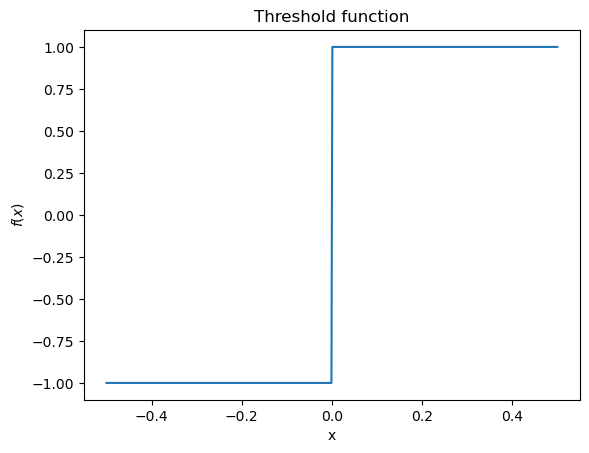

In [3]:
inp = torch.linspace(-0.5, 0.5, 500)
plt.plot(inp, threshold_function(inp))
plt.title("Threshold function")
plt.xlabel("x")
plt.ylabel(r"$f(x)$");

## Neuron model

In [4]:
class NeuronModelV0:
    def __init__(self, weights, bias=None, activation_fn=threshold_function):
        # Initialize weights and bias
        self.weights = weights  # num_dim inputs
        if bias is None:
            bias = torch.zeros(1)
        self.bias = bias
        self.activation_fn = activation_fn

    def forward(self, x):
        # Compute the output of the neuron
        z = torch.matmul(x, self.weights) + self.bias  # (N,) shape
        return z

    def predict(self, x):
        # Compute the output of the neuron
        z = torch.matmul(x, self.weights) + self.bias  # (N,) shape
        return self.activation_fn(z)

# Classification: Linearly separable classes

## Generate dataset

In [5]:
def generate_separable_dataset(N, b = 0):

    C0_x0 = np.random.random(N)
    C0_x1 = (C0_x0 - [np.random.randint(10)/10 for i in range(N)] - 0.1 + b)
    C0 = np.stack((C0_x0, C0_x1), axis=1)

    C1_x0 = np.random.random(N)
    C1_x1 = (C1_x0 + [np.random.randint(10)/10 for i in range(N)] + 0.1 + b)
    C1 = np.stack((C1_x0, C1_x1), axis=1)

    plt.scatter(C0[:, 0], C0[:, 1], s=50, c='green', edgecolor='white', linewidth=1, label='Class -1')
    plt.scatter(C1[:, 0], C1[:, 1], s=50, c='blue', edgecolor='white', linewidth=1, label='Class 1')
    plt.xlim([-0.1,1.1])
    plt.ylim([-1.1,2.1 + b])
    plt.grid(True)
    plt.legend()

    return C0, C1

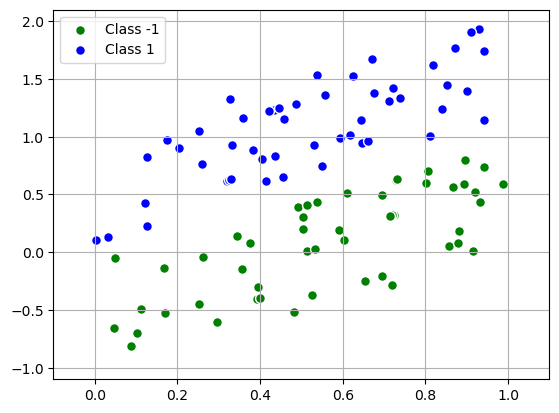

In [6]:
N = 50
C0, C1 = generate_separable_dataset(N)

## Selecting neuron parameters

In [13]:
from matplotlib.colors import ListedColormap

def plot_decision_boundary(C0, C1, model, xlims, ylims):
    # Create a mesh grid for the decision boundary
    feature_1, feature_2 = np.meshgrid(
        np.linspace(*xlims, 1000),
        np.linspace(*ylims, 1000)
    )
    grid = np.vstack([feature_1.ravel(), feature_2.ravel()]).T.astype(np.float32)

    # Predict values for the grid
    pred = np.reshape(model.predict(torch.from_numpy(grid)).numpy(), feature_1.shape)

    # Define a custom colormap to match scatter points
    cmap = ListedColormap(['green', 'blue'])

    # Plot the decision boundary using the custom colormap
    plt.contourf(feature_1, feature_2, pred, levels=[-1, 0, 1], cmap=cmap, alpha=0.2)
    
    # Scatter points for class 0 and class 1
    plt.scatter(C0[:, 0], C0[:, 1], s=50, c='green', edgecolor='white', linewidth=1, label="Class 0")
    plt.scatter(C1[:, 0], C1[:, 1], s=50, c='blue', edgecolor='white', linewidth=1, label="Class 1")
    
    # Axis labels and legend
    plt.xlim(xlims)
    plt.ylim(ylims)
    plt.xlabel("x0")
    plt.ylabel("x1")
    plt.legend()
    plt.grid()
    plt.show()


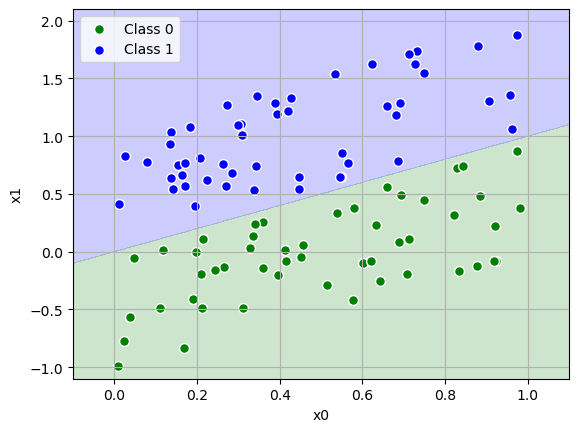

In [ ]:
weights = torch.Tensor([-1, 1])

nn = NeuronModelV0(weights=weights)

plot_decision_boundary(C0, C1, nn, xlims=[-0.1,1.1], ylims=[-1.1,2.1])

# Adding bias

## Adjusting previous dataset

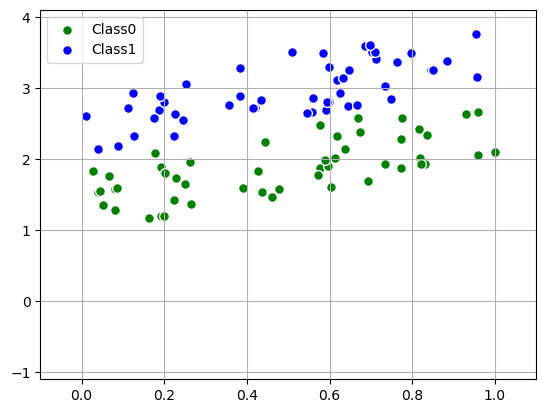

In [383]:
N = 50
b = 2
C0, C1 = generate_separable_dataset(N, b)

## Results of model without bias

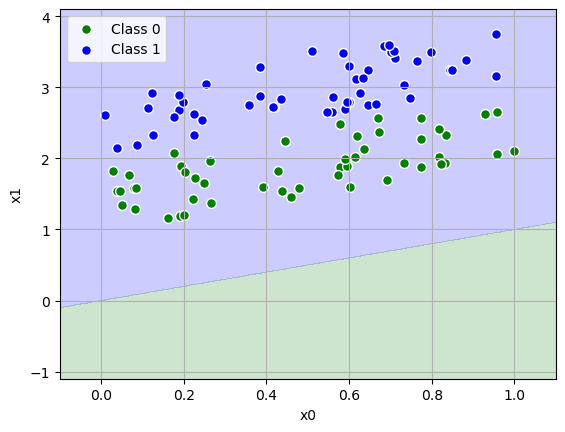

In [ ]:
weights = torch.Tensor([-1, 1])

nn = NeuronModelV0(weights=weights)
plot_decision_boundary(C0, C1, nn, xlims=[-0.1,1.1], ylims=[-1.1,4.1])


## Results of model with bias

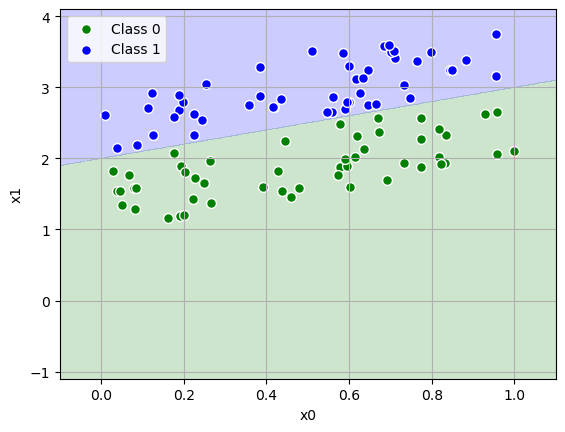

In [ ]:
bias = torch.Tensor([-2])
weights = torch.Tensor([-1, 1])

nn = NeuronModelV0(weights=weights, bias=bias)
plot_decision_boundary(C0, C1, nn, xlims=[-0.1,1.1], ylims=[-1.1,4.1])


Well, we have managed to guess weights and bias of single neuron. However, obviously, it can't be applied to real problems. Let's try to use gradient descent to find correct parameters.

### Loss function

Lets consider the simplest loss function:
$$\hat{y_i} = sign\langle\omega, x_i\rangle$$

$$L =\frac{1}{N} \sum_i[y_i \ne sign\langle\omega, x_i\rangle] \rightarrow min$$

Multiply both parts by $y_i$:
$$L =\frac{1}{N} \sum_i[y_i\langle\omega, x_i\rangle < 0] \rightarrow min$$

$M_i = y_i\langle\omega, x_i\rangle$ - margin, takes into account how strong model is confident in it's prediction$

$$L = F(M) = [M < 0]$$
This loss function has derrivative equals zero, so we can give upper bound for out loss function:
$L \le max(0, -M)$
Insert pucture

$$L = \frac{1}{N}\sum_{i}max(0, -y_i\langle\omega, x_i\rangle)$$

$$∇L_w = \frac{1}{N}\sum_i \begin{cases}
      0, & y_i\langle\omega, x_i\rangle > 0 \\
      -y_ix_i, &  y_i\langle\omega, x_i\rangle \le 0
   \end{cases}$$


$$∇L_b =\frac{1}{N} \sum_i \begin{cases}
      0, & y_i\langle\omega, x_i\rangle > 0 \\
      -y_i, &  y_i\langle\omega, x_i\rangle \le 0
   \end{cases}$$

In [7]:
class NeuronModelV1(NeuronModelV0):
    def __init__(self, weights, bias):
        super().__init__(weights=weights, bias=bias)

    def perceptron_loss(self, x, y):
        z = self.forward(x)
        loss = torch.maximum(torch.tensor(0.0), -y * z)  # Perceptron loss
        return loss.mean()  # Return mean loss over all samples

    def calculate_gradients(self, x, y):
        # Calculate forward output
        z = self.forward(x)
        # Calculate the gradient of the loss with respect to z
        grad_z = -y * ((y * z) < 0).float()  # Gradient is -y if z < 0, else 0
        # Compute gradients for weights and bias
        grad_w = torch.matmul(x.t(), grad_z) / x.size(0)  # Average over batch
        grad_b = grad_z.mean()  # Average gradient for bias
        return grad_w, grad_b

## Dataset without bias

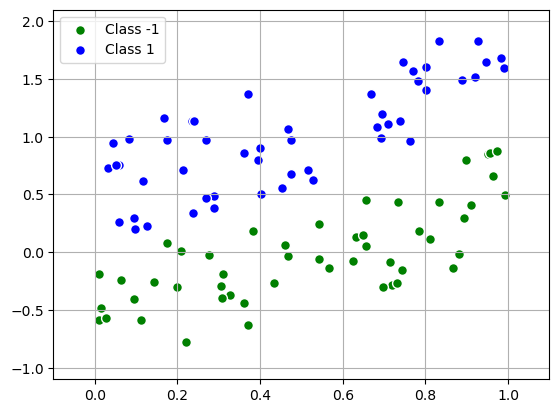

In [8]:
C0, C1 = generate_separable_dataset(N, b=0)

In [ ]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

weights = torch.randn(2, requires_grad=False)  # Random initial weights
bias = torch.zeros(1, requires_grad=False)     # Zero initial bias
model = NeuronModelV1(weights=weights, bias=bias)

X_data = torch.tensor(np.vstack([C0, C1]), dtype=torch.float32)
y_data = torch.cat([torch.ones(N), torch.ones(N) * -1])  # 0 for C0, 1 for C1

fig, ax = plt.subplots(figsize=(8, 6))
ax.scatter(C0[:, 0], C0[:, 1], color='green', label='Class 1')
ax.scatter(C1[:, 0], C1[:, 1], color='blue', label='Class -1')
x_values = np.linspace(0, 1, 100)
line, = ax.plot(x_values, x_values, color='black', label='Decision Boundary')
ax.set_xlim([-0.1,1.1])
ax.set_ylim([-1.1,2.1])
ax.set_xlabel("x0")
ax.set_ylabel("x1")
ax.legend()
ax.grid()

learning_rate = 0.1
epochs = 300

losses = []

def update(epoch):
    # Calculate gradients
    # with torch.no_grad():
    grad_weights, grad_bias = model.calculate_gradients(X_data, y_data)
    loss = model.perceptron_loss(X_data, y_data)
    losses.append(loss.item())
    model.weights = model.weights -  learning_rate * grad_weights
    model.bias = model.bias -  learning_rate * grad_bias

    y_values = (-model.weights[0] * x_values - model.bias) / model.weights[1]
    line.set_ydata(y_values)  # Update the y-data of the line only
    ax.set_title(f"Epoch {epoch + 1}, loss: {loss.item():.4f}")

# Animation
ani = FuncAnimation(fig, update, frames=epochs, repeat=False)

# Save animation as an HTML5 video and display it in Google Colab
plt.close(fig)
HTML(ani.to_jshtml())

<module 'matplotlib.pyplot' from 'c:\\Users\\sokol\\miniconda3\\Lib\\site-packages\\matplotlib\\pyplot.py'>

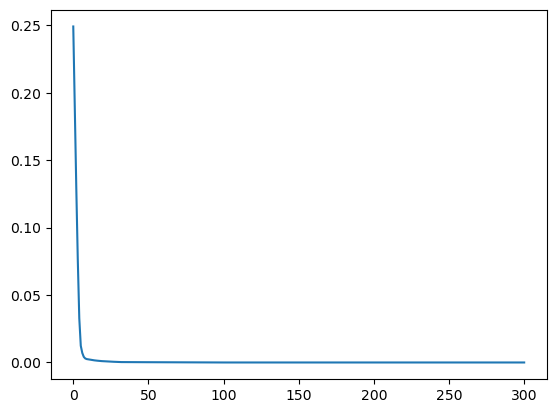

In [18]:
plt.plot(losses)
plt

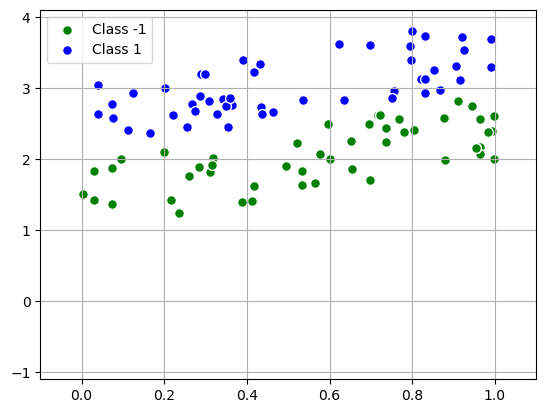

In [9]:
C0, C1 = generate_separable_dataset(N, b=2)

In [ ]:
b = 2
weights = torch.randn(2, requires_grad=False)  # Random initial weights
bias = torch.zeros(1, requires_grad=False)     # Zero initial bias
model = NeuronModelV1(weights=weights, bias=bias)

X_data = torch.tensor(np.vstack([C0, C1]), dtype=torch.float32)
y_data = torch.cat([torch.ones(N), torch.ones(N) * -1])  # 0 for C0, 1 for C1

fig, ax = plt.subplots(figsize=(8, 6))
ax.scatter(C0[:, 0], C0[:, 1], color='green', label='Class 1')
ax.scatter(C1[:, 0], C1[:, 1], color='blue', label='Class -1')
x_values = np.linspace(0, 1, 100)
line, = ax.plot(x_values, x_values, color='black', label='Decision Boundary')
ax.set_xlim([-0.1,1.1])
ax.set_ylim([-1.1 + b,2.1 + b])
ax.set_xlabel("x0")
ax.set_ylabel("x1")
ax.legend()
ax.grid()

learning_rate = 0.1
epochs = 300

losses = []

def update(epoch):
    # Calculate gradients
    # with torch.no_grad():
    grad_weights, grad_bias = model.calculate_gradients(X_data, y_data)
    loss = model.perceptron_loss(X_data, y_data)
    losses.append(loss.item())
    model.weights = model.weights -  learning_rate * grad_weights
    model.bias = model.bias -  learning_rate * grad_bias

    y_values = (-model.weights[0] * x_values - model.bias) / model.weights[1]
    line.set_ydata(y_values)  # Update the y-data of the line only
    ax.set_title(f"Epoch {epoch + 1}, loss: {loss.item():.4f}")

# Animation
ani = FuncAnimation(fig, update, frames=epochs, repeat=False)

# Save animation as an HTML5 video and display it in Google Colab
plt.close(fig)
HTML(ani.to_jshtml())

# Classification: lineary non-separable classes

## Generating dataset

In [10]:
def threshold_function(x):
    return (x >= 0).float()

(-0.1, 1.1)

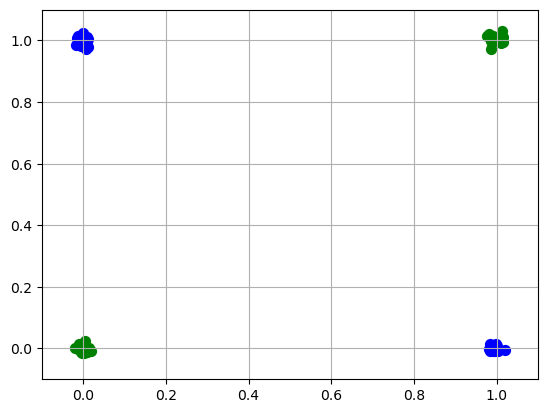

In [11]:
N = 20
noise_scale = 0.01

C1_anchor = np.array([(0, 1), (1, 0)])  # Positive class
C0_anchor = np.array([(0, 0), (1, 1)])  # Negative class

C1 = np.vstack([c + noise_scale * np.random.randn(N, 2) for c in C1_anchor])
C0 = np.vstack([c + noise_scale * np.random.randn(N, 2) for c in C0_anchor])


# plotting
plt.scatter(C0[:, 0], C0[:, 1], s=50, c='green')
plt.scatter(C1[:, 0], C1[:, 1], s=50, c='blue')
plt.grid(True)
plt.xlim([-0.1,1.1])
plt.ylim([-0.1,1.1])

## results of previous model with bias

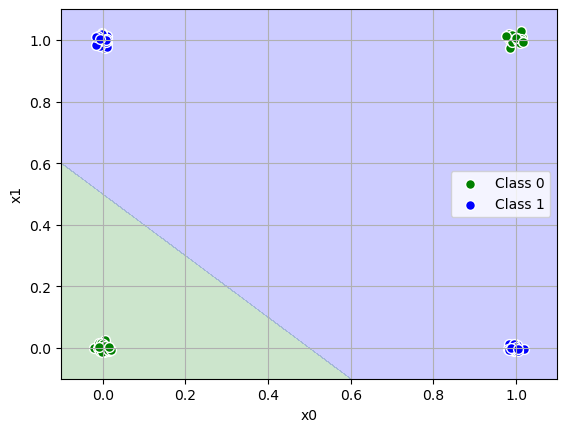

In [14]:
weights = torch.Tensor([1, 1])
bias = torch.Tensor([-0.5])
nn = NeuronModelV1(weights=weights, bias=bias)

plot_decision_boundary(
    C0, C1,
    nn,
    xlims=[-0.1,1.1], ylims=[-0.1,1.1]
)

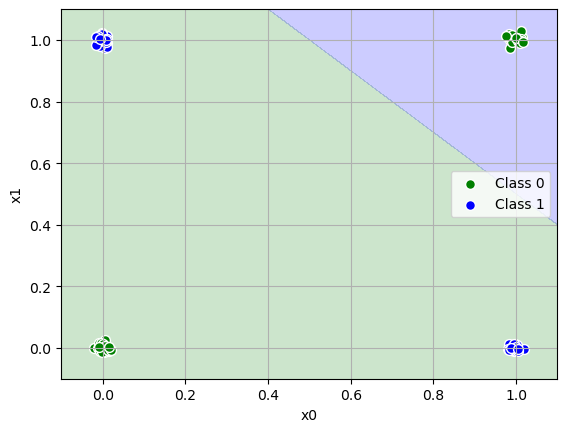

In [15]:
weights = torch.Tensor([1, 1])
bias = torch.Tensor([-1.5])
nn = NeuronModelV1(weights=weights, bias=bias)

plot_decision_boundary(
    C0, C1,
    nn,
    xlims=[-0.1,1.1], ylims=[-0.1,1.1]
)

## Building more complex model: Perceptron

In [16]:
def threshold_function(x):
    return (x > 0).float()

In [17]:
class Perceptron:
    def __init__(self, W1, b1, W2, b2, W3, b3):
        self.n1 = NeuronModelV1(W1, b1)
        self.n2 = NeuronModelV1(W2, b2)
        self.n3 = NeuronModelV1(W3, b3)

    def predict(self, x: torch.Tensor) -> torch.Tensor:
        z1_1 = self.n1.forward(x)
        z1_2 = self.n2.forward(x)

        a1_1 = threshold_function(z1_1).to(torch.float32)
        a1_2 = threshold_function(z1_2).to(torch.float32)
        a2 = torch.stack((a1_1, a1_2), axis=1)
        z3 = self.n3.forward(a2)
        y = threshold_function(z3)
        return y


## Selecting paramaters for Perceptron

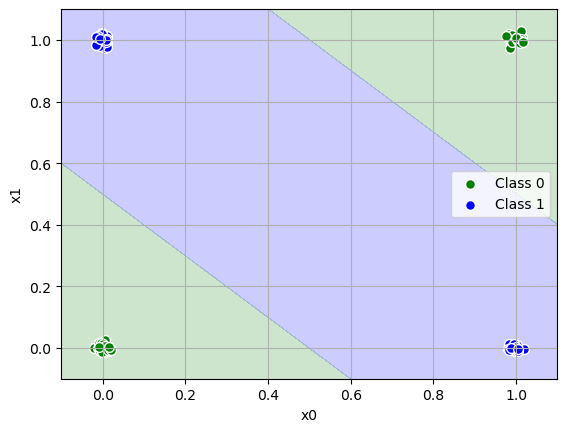

In [18]:
W1 = torch.Tensor([1, 1])
b1 = torch.Tensor([-0.5])

W2 = torch.Tensor([1, 1])
b2 = torch.Tensor([-1.5])

W3 = torch.Tensor([1, -2])
b3 = torch.Tensor([0])

nn = Perceptron(W1, b1, W2, b2, W3, b3)

plot_decision_boundary(
    C0, C1,
    nn,
    xlims=[-0.1,1.1], ylims=[-0.1,1.1]
)

In [19]:
class CustomLinearLayer:
    def __init__(self, W, b):
        self.W = W
        self.b = b

    def forward(self, x:torch.Tensor):
        return x @ self.W + self.b
    
class LayerPerceptron:
    def __init__(self, W1, b1, W2, b2):
        self.layer1 = CustomLinearLayer(W1, b1)
        self.layer2 = CustomLinearLayer(W2, b2)

    def predict(self, x: torch.Tensor) -> torch.Tensor:
        a1 = threshold_function(self.layer1.forward(x)).to(torch.float32)
        y = threshold_function(self.layer2.forward(a1))
        return y

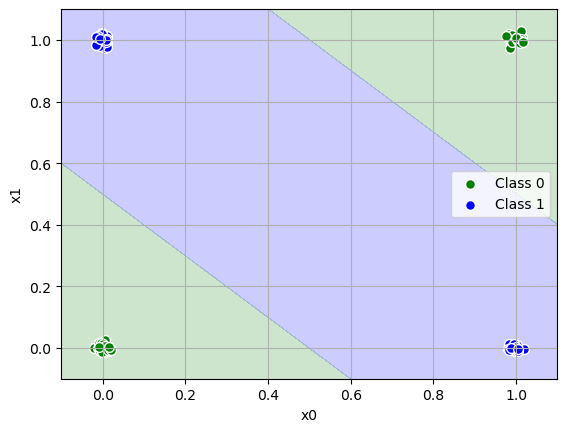

In [20]:
W1 = torch.Tensor([[1, 1], [1, 1]])
b1 = torch.Tensor([-0.5, -1.5])

W2 = torch.Tensor([[1], [-2]])
b2 = torch.Tensor([0])

nn = LayerPerceptron(W1, b1, W2, b2)

plot_decision_boundary(
    C0, C1,
    nn,
    xlims=[-0.1,1.1], ylims=[-0.1,1.1]
)

## Let's train this model

### Raw training

First of all, we will ommit the fact, that torch has autograd and optimizers. We will try to do all the traning process by ourself.

In [ ]:
class BCE:
    def __init__(self):
        self.eps = 1e-12

    def forward(self, y_gt, y_pred):
        return - (y_gt * y_pred.clamp(min=self.eps).log() + (1 - y_gt) * (1 - y_pred).clamp(min=self.eps).log()).mean()

    def backward(self, y_gt, y_pred):
        return -(y_gt / (y_pred + self.eps) - (1 - y_gt) / (1 - y_pred + self.eps)) / y_gt.shape[0]


class Sigmoid:
    def forward(self, z):
        self.forward_output = 1 / (1 + torch.exp(-z))
        return self.forward_output

    def backward(self, grad_outputs):
        deriv = self.forward_output * (1 - self.forward_output)
        return grad_outputs * deriv


class LinearLayer:
    def __init__(self, W, b):
        self.weights = W
        self.bias = b

    def forward(self, x: torch.Tensor):
        self.forward_inputs = x
        return x @ self.weights + self.bias

    def backward(self,grad_outputs ):
        self.weights_grad = self.forward_inputs.T @ grad_outputs
        self.biases_grad = grad_outputs.sum(axis=0)
        return grad_outputs @ self.weights.T


class PerceptronWithGradient:
    def __init__(self, W1, b1, W2, b2):
        self.layer1 = LinearLayer(W1, b1)
        self.activation1 = Sigmoid()
        self.layer2 = LinearLayer(W2, b2)
        self.activation2 = Sigmoid()
        self.loss_fn = BCE()

    def forward(self, x):
        """
        Forward pass through the model.
        """
        self.z1 = self.layer1.forward(x)
        self.a1 = self.activation1.forward(self.z1)
        self.z2 = self.layer2.forward(self.a1)
        self.y_pred = self.activation2.forward(self.z2)
        return self.y_pred

    def backward(self, y_pred, y_gt):
        """
        Backward pass through the model to compute gradients.
        """
        # Loss gradient w.r.t. predictions
        grad_y_pred = self.loss_fn.backward(y_gt, y_pred)

        # Backpropagate through second Sigmoid
        grad_z2 = self.activation2.backward(grad_y_pred)

        # Backpropagate through second Linear Layer
        grad_a1 = self.layer2.backward(grad_z2)

        # Backpropagate through first Sigmoid
        grad_z1 = self.activation1.backward(grad_a1)

        # Backpropagate through first Linear Layer
        grad_x = self.layer1.backward(grad_z1)
        return self.layer1.weights_grad, self.layer1.biases_grad, self.layer2.weights_grad, self.layer2.biases_grad


In [403]:
from matplotlib.colors import ListedColormap
from tqdm.notebook import tqdm
# Generate Point Clouds Around C0 and C1
N = 20
noise_scale = 0.01

C1_anchor = np.array([(0, 1), (1, 0)])  # Positive class
C0_anchor = np.array([(0, 0), (1, 1)])  # Negative class

C1 = np.vstack([c + noise_scale * np.random.randn(N, 2) for c in C1_anchor])
C0 = np.vstack([c + noise_scale * np.random.randn(N, 2) for c in C0_anchor])

X_data = torch.tensor(np.vstack([C0, C1]), dtype=torch.float32)
y_data = torch.tensor([0] * (2 * N) + [1] * (2 * N), dtype=torch.float32).reshape(-1, 1)

# Initialize Model
W1 = torch.randn(2, 2, requires_grad=False)
b1 = torch.zeros(2, requires_grad=False)
W2 = torch.randn(2, 1, requires_grad=False)
b2 = torch.zeros(1, requires_grad=False)
model = PerceptronWithGradient(W1, b1, W2, b2)

# Visualization Setup
fig, ax = plt.subplots(figsize=(8, 6))

# Plot Data Points
scatter_C0 = ax.scatter(C0[:, 0], C0[:, 1], color='green', label='Class 0')
scatter_C1 = ax.scatter(C1[:, 0], C1[:, 1], color='blue', label='Class 1')

# Setup Mesh Grid for Decision Boundary
x_values = np.linspace(-0.1, 1.1, 100)
y_values = np.linspace(-0.1, 1.1, 100)
X_mesh, Y_mesh = np.meshgrid(x_values, y_values)
mesh_inputs = torch.tensor(np.c_[X_mesh.ravel(), Y_mesh.ravel()], dtype=torch.float32)

# Initial Decision Boundary Visualization
cmap = ListedColormap(['green', 'blue'])
decision_boundary = ax.contourf(X_mesh, Y_mesh, np.zeros_like(X_mesh), levels=2, alpha=0.3, cmap=cmap)

ax.set_xlim([-0.1, 1.1])
ax.set_ylim([-0.1, 1.1])
ax.set_xlabel("x0")
ax.set_ylabel("x1")
ax.legend()
ax.grid()

learning_rate = 0.01
epochs = 50_000  # Total epochs
frames_to_display = 250  # Number of frames in the animation
interval = epochs // frames_to_display  # Interval for updating animation frames
losses = []

# Training Function
def update(frame):
    global decision_boundary

    # Only update and visualize at specific intervals
    current_epoch = frame * interval
    
    for _ in range(interval):
        # Perform training step
        y_pred = model.forward(X_data)
        grad_W1, grad_b1, grad_W2, grad_b2 = model.backward(y_pred, y_data)
        loss = model.loss_fn.forward(y_data, y_pred)
        losses.append(loss.item())

        # Update Weights
        model.layer1.weights -= learning_rate * grad_W1
        model.layer1.bias -= learning_rate * grad_b1
        model.layer2.weights -= learning_rate * grad_W2
        model.layer2.bias -= learning_rate * grad_b2

    # Update Decision Boundary for visualization
    with torch.no_grad():
        mesh_pred = model.forward(mesh_inputs).reshape(X_mesh.shape)
        for c in decision_boundary.collections:
            c.remove()
        decision_boundary = ax.contourf(X_mesh, Y_mesh, mesh_pred, levels=2, alpha=0.3, cmap=cmap)
    
    ax.set_title(f"Epoch {current_epoch + 1}, Loss: {loss.item():.4f}")

# Animation
ani = FuncAnimation(fig, update, frames=frames_to_display, repeat=False)
plt.close(fig)
HTML(ani.to_jshtml())

C:\Users\sokol\AppData\Local\Temp\ipykernel_31928\2474540598.py:76: MatplotlibDeprecationWarning: The collections attribute was deprecated in Matplotlib 3.8 and will be removed in 3.10.
  for c in decision_boundary.collections:


In [404]:
def plot_loss(losses):
    plt.plot(losses)
    plt.xlabel('iter')
    plt.ylabel('loss')
    plt.grid()

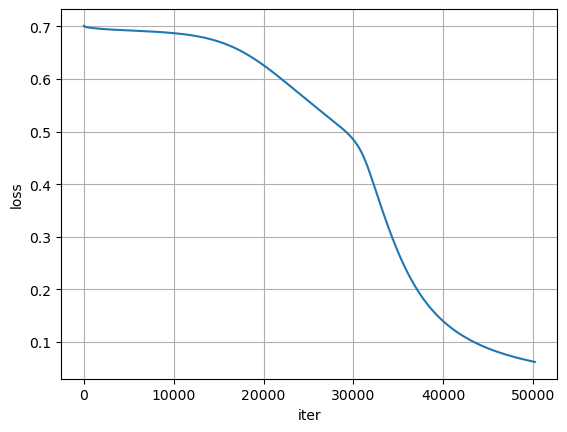

In [405]:
plot_loss(losses)

## Autograd

In [ ]:
class AutoLinearLayer:
    def __init__(self, in_features, out_features):
        self.weights = torch.randn(in_features, out_features, requires_grad=True)
        self.bias = torch.randn(out_features, requires_grad=True)

    def forward(self, x:torch.Tensor):
        return x @ self.weights + self.bias
    
class PerceptronWithGradient:
    def __init__(self, in_features, latent_features, out_features):
        self.layer1 = AutoLinearLayer(in_features, latent_features)
        self.activation1 = Sigmoid()
        self.layer2 = AutoLinearLayer(latent_features, out_features)
        self.activation2 = Sigmoid()

    def forward(self, x):
        """
        Forward pass through the model.
        """
        self.z1 = self.layer1.forward(x)
        self.a1 = self.activation1.forward(self.z1)
        self.z2 = self.layer2.forward(self.a1)
        self.y_pred = self.activation2.forward(self.z2)
        return self.y_pred

In [273]:
iterations = 50_000
lr = 0.01
loss_history = []
loss_fn = torch.nn.BCELoss()
model = PerceptronWithGradient(2, 2, 1)

for i in range(iterations):
    loss = loss_fn(model.forward(X_data), y_data)
    loss_history.append(loss.item())
    loss.backward()

    model.layer1.weights.data -= learning_rate * model.layer1.weights.grad.data
    model.layer1.bias.data -= learning_rate * model.layer1.bias.grad.data
    model.layer2.weights.data -= learning_rate * model.layer2.weights.grad.data
    model.layer2.bias.data -= learning_rate * model.layer2.bias.grad.data

    model.layer1.weights.grad.data.zero_()
    model.layer1.bias.grad.data.zero_()
    model.layer2.weights.grad.data.zero_()
    model.layer2.bias.grad.data.zero_()

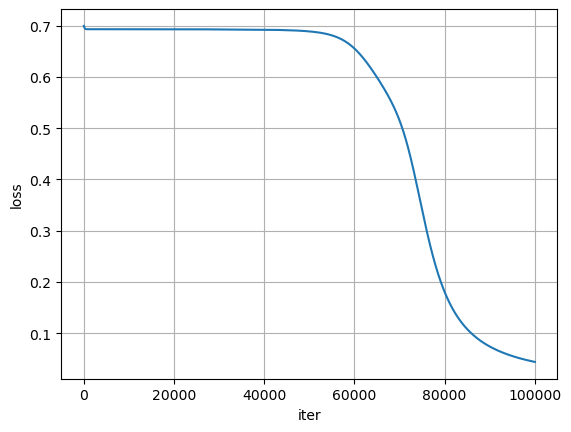

In [409]:
plot_loss(loss_history);

## torch.nn and optimizers

In [310]:
from torch import nn

class PerceptronWithGradient(nn.Module):
    def __init__(self, in_features, latent_features, out_features):
        super().__init__()
        self.model = nn.Sequential(
            torch.nn.Linear(in_features, latent_features),
            torch.nn.Sigmoid(),
            torch.nn.Linear(latent_features, out_features),
            torch.nn.Sigmoid()
        )
        
    def forward(self, x):
        """
        Forward pass through the model.
        """
        return self.model(x)

In [311]:
iterations = 100_000
lr = 0.01
loss_history = []
loss_fn = torch.nn.BCELoss()
model = PerceptronWithGradient(2, 2, 1)
optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate)

for i in range(iterations):
    optimizer.zero_grad()
    loss = loss_fn(model.forward(X_data), y_data)
    loss_history.append(loss.item())
    loss.backward()
    optimizer.step()

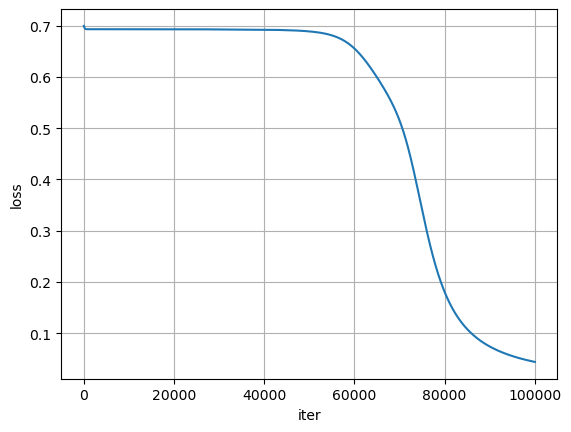

In [408]:
plot_loss(loss_history);

## nn.Sequential

In [313]:
class PerceptronWithGradient(torch.nn.Sequential):
    def __init__(self, in_features, latent_features, out_features):
        super().__init__()
        self.layer1 = torch.nn.Linear(in_features, latent_features)
        self.activation1 = torch.nn.Sigmoid()
        self.layer2 = torch.nn.Linear(latent_features, out_features)
        self.activation2 = torch.nn.Sigmoid()

In [316]:
iterations = 100_000
lr = 0.01
loss_history = []
loss_fn = torch.nn.BCELoss()
model = PerceptronWithGradient(2, 2, 1)
optimizer = torch.optim.SGD(model.parameters(), lr=learning_rate)

for i in range(iterations):
    optimizer.zero_grad()
    loss = loss_fn(model(X_data), y_data)
    loss_history.append(loss.item())
    loss.backward()
    optimizer.step()

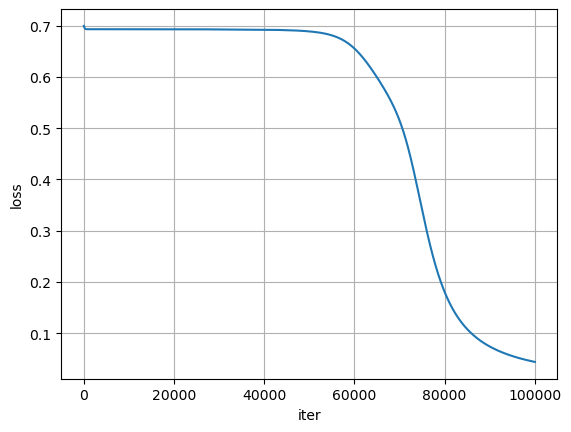

In [407]:
plot_loss(loss_history);

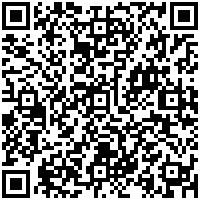